## Importing the libraries ##

In [1]:
%matplotlib inline
import math
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import seaborn as sns


## Loading Dataframes ##


In [2]:
#read the csv file where contains the dataset using data parsing on dates
dateparse = lambda dates: pd.datetime.strptime(dates, '%Y-%m-%d')
df_city_temp = pd.read_csv('./CityGlobalTemperature2000-2009.csv', sep = ',', parse_dates=True, index_col='time', date_parser=dateparse)
df_city_temp.head(121)

/tmp/ipykernel_10139/2343883371.py:2: FutureWarning: The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.
  dateparse = lambda dates: pd.datetime.strptime(dates, '%Y-%m-%d')


,Unnamed: 0,AverageTemperature,AverageTemperatureUncertainty,City,Country,Latitude,Longitude
time,,,,,,,
2000-02-01,1813,27.685,0.267,Abidjan,Côte D'Ivoire,5.63N,3.23W
2000-03-01,1814,29.061,0.224,Abidjan,Côte D'Ivoire,5.63N,3.23W
2000-04-01,1815,28.162,0.478,Abidjan,Côte D'Ivoire,5.63N,3.23W
2000-05-01,1816,27.547,0.509,Abidjan,Côte D'Ivoire,5.63N,3.23W
2000-06-01,1817,25.812,0.231,Abidjan,Côte D'Ivoire,5.63N,3.23W
...,...,...,...,...,...,...,...
2009-10-01,1929,26.354,0.568,Abidjan,Côte D'Ivoire,5.63N,3.23W
2009-11-01,1930,27.497,0.413,Abidjan,Côte D'Ivoire,5.63N,3.23W
2009-12-01,1931,27.620,0.412,Abidjan,Côte D'Ivoire,5.63N,3.23W


# Data Understanding #

Studying the different types of data of the dataframe.

In [3]:
df_city_temp.dtypes

Unnamed: 0                         int64
AverageTemperature               float64
AverageTemperatureUncertainty    float64
City                              object
Country                           object
Latitude                          object
Longitude                         object
dtype: object

In [4]:
#check how many cities in dataframe
df_city_temp["City"].unique().size

100

In [5]:
df_city_temp.describe()

,Unnamed: 0,AverageTemperature,AverageTemperatureUncertainty
count,12000.000000,12000.000000,12000.000000
mean,121394.670000,19.708932,0.362474
std,69143.708067,9.502997,0.203973
min,1813.000000,-23.495000,0.056000
25%,62527.500000,14.829000,0.234000
50%,120939.000000,22.077000,0.316000
75%,181756.500000,26.931000,0.427000
max,239132.000000,38.283000,2.854000



## Studying null values in the Dataframes ##

Below there is the number of __null__ values per attribute, so we don't have any missing values.

In [6]:
df_city_temp.isnull().sum()

Unnamed: 0                       0
AverageTemperature               0
AverageTemperatureUncertainty    0
City                             0
Country                          0
Latitude                         0
Longitude                        0
dtype: int64

## Preprocessing 

We created a copy of dataframe with only __time__, __AverageTemperature__ and __City__. The most important attributes for our task.

In [7]:
df_city = df_city_temp[["AverageTemperature","City"]].copy()
df_city.describe

<bound method NDFrame.describe of             AverageTemperature     City
time                                   
2000-02-01              27.685  Abidjan
2000-03-01              29.061  Abidjan
2000-04-01              28.162  Abidjan
2000-05-01              27.547  Abidjan
2000-06-01              25.812  Abidjan
...                        ...      ...
2009-09-01              18.459     Xian
2009-10-01              14.195     Xian
2009-11-01               2.916     Xian
2009-12-01              -0.712     Xian
2010-01-01              -0.237     Xian

[12000 rows x 2 columns]>

We have split the data frame in each city's time series.

In [8]:
#split dataset according to city
ts_array = np.array_split(df_city, 100)
ts_array

[            AverageTemperature     City
 time                                   
 2000-02-01              27.685  Abidjan
 2000-03-01              29.061  Abidjan
 2000-04-01              28.162  Abidjan
 2000-05-01              27.547  Abidjan
 2000-06-01              25.812  Abidjan
 ...                        ...      ...
 2009-09-01              25.568  Abidjan
 2009-10-01              26.354  Abidjan
 2009-11-01              27.497  Abidjan
 2009-12-01              27.620  Abidjan
 2010-01-01              28.270  Abidjan
 
 [120 rows x 2 columns],
             AverageTemperature         City
 time                                       
 2000-02-01              19.183  Addis Abeba
 2000-03-01              20.230  Addis Abeba
 2000-04-01              20.398  Addis Abeba
 2000-05-01              19.977  Addis Abeba
 2000-06-01              18.254  Addis Abeba
 ...                        ...          ...
 2009-09-01              18.187  Addis Abeba
 2009-10-01              17.788  Ad

### Studying time series 

Below we have plotted the dataframe to see the AverageTemperature trend.

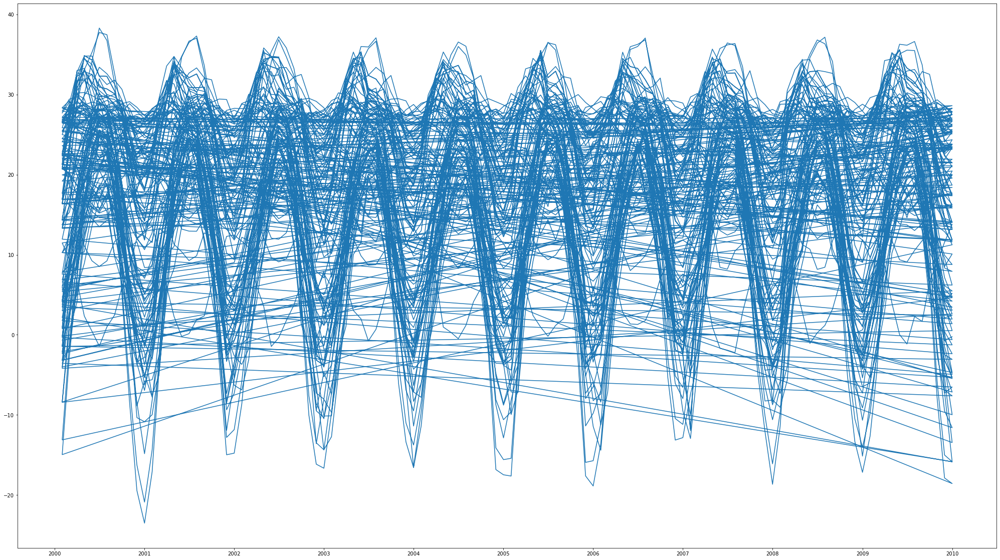

In [9]:
#plot the average temperature
ts = df_city['AverageTemperature']
plt.figure(figsize=(35,20))
plt.plot(ts)
plt.show()

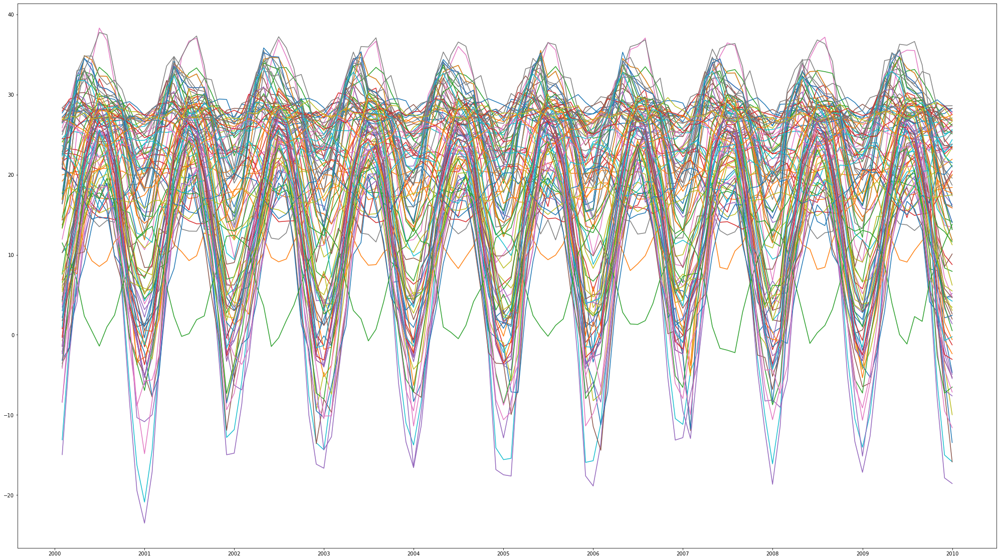

In [10]:
#plot average temperature for all cities
plt.figure(figsize=(35,20))
for i in range(len(ts_array)):
    plt.plot(ts_array[i]['AverageTemperature'])
plt.show()

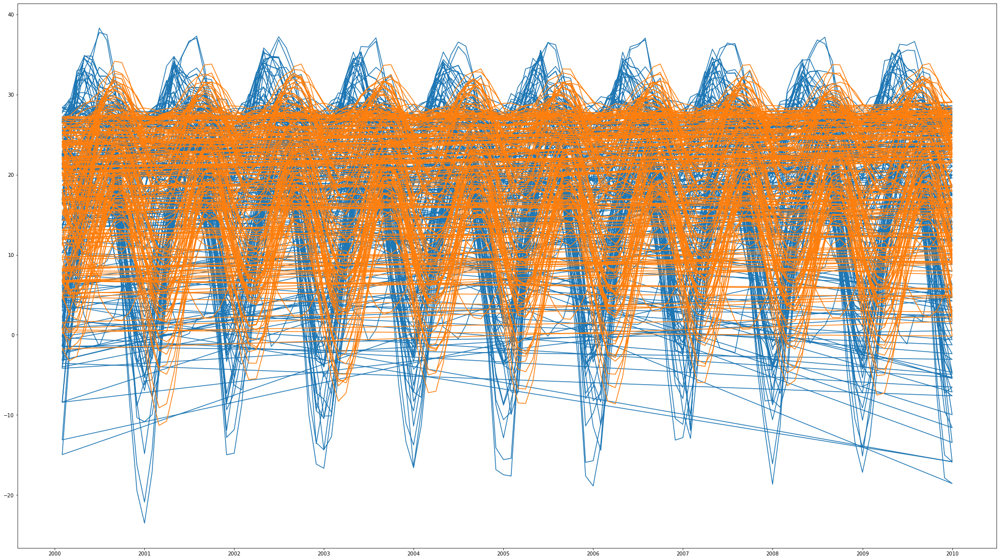

In [11]:
#we plot the mean for window size equal to 12 months 
plt.figure(figsize=(35,20))
plt.plot(ts)
plt.plot(ts.rolling(window=6).mean())
plt.show()

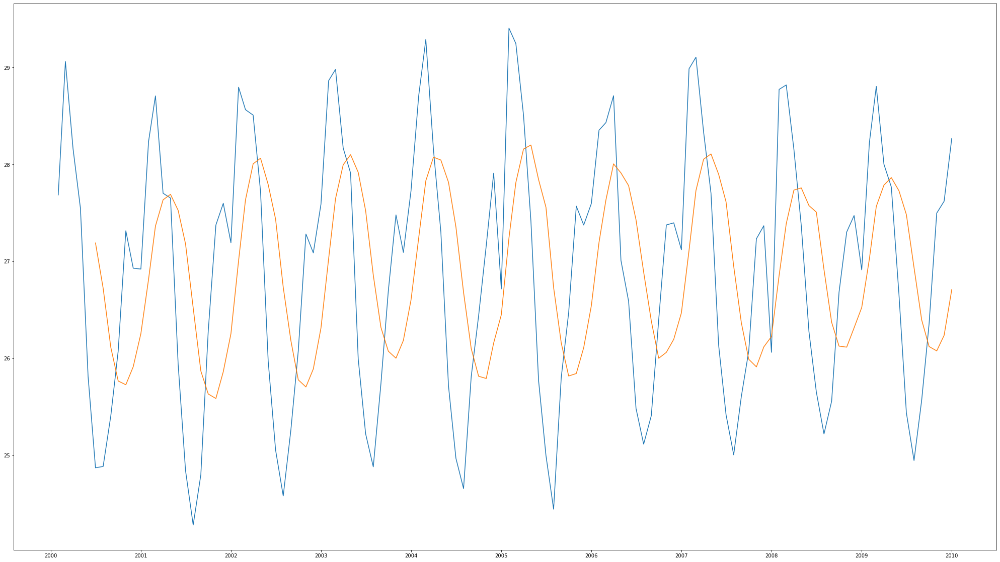

In [12]:
#example with one city (Abidjan) with x months
plt.figure(figsize=(35,20))
plt.plot(ts_array[0]['AverageTemperature'])
plt.plot(ts_array[0]['AverageTemperature'].rolling(window=6).mean())
plt.show()

Now, we have shifted time series per city.

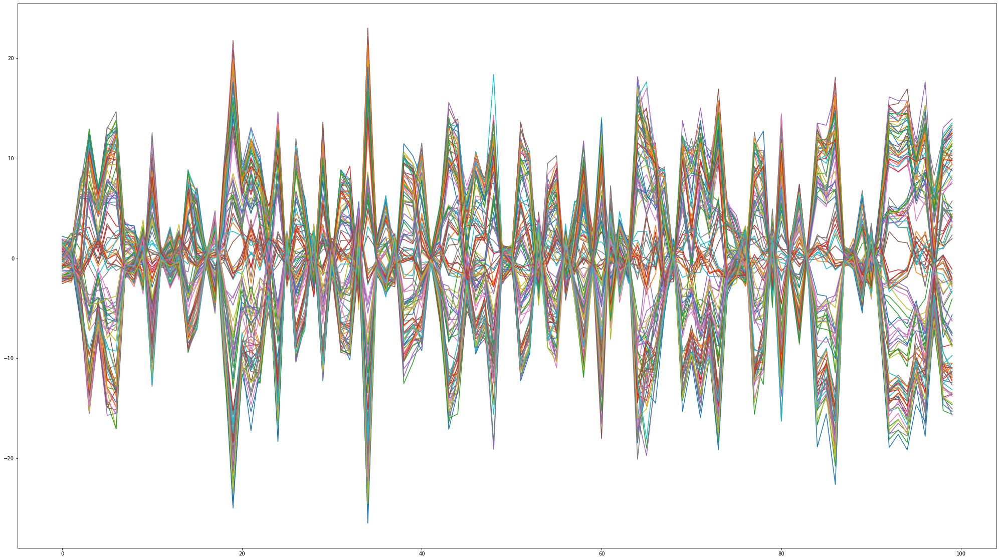

In [13]:
#iterator i correspond to the city
ts_shift_array = []
for i in range(len(ts_array)):
    ts_shift_array.append(ts_array[i]['AverageTemperature'] - ts_array[i]['AverageTemperature'].rolling(window=6).mean())
plt.figure(figsize=(35,20))
plt.plot(ts_shift_array)
plt.show()

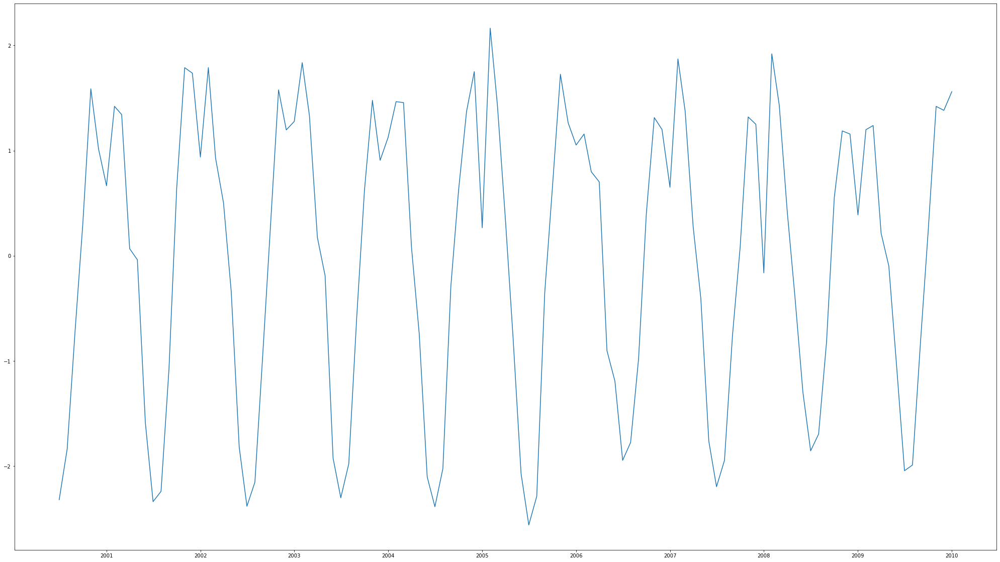

In [14]:
plt.figure(figsize=(35,20))
plt.plot(ts_shift_array[0])
plt.show()

 ## Removing noise
 
 In this section, we have removed the noise by applying some techniques including the scaler min-max. 

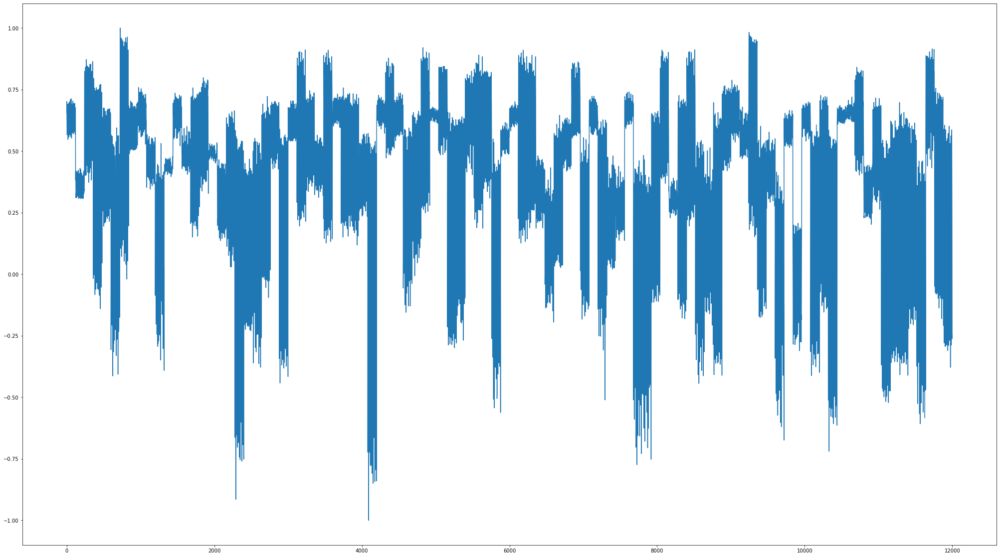

In [15]:
#scaler min-max
from tslearn.preprocessing import TimeSeriesScalerMinMax
scaler = TimeSeriesScalerMinMax(value_range=(-1., 1.))  
ts_scaled_test = scaler.fit_transform(ts.values.reshape(1, -1)).flatten()

plt.figure(figsize=(35,20))
plt.plot(ts_scaled_test)
plt.show()

There we have split among cities' time series and we have converted the list split in a NumPy array.

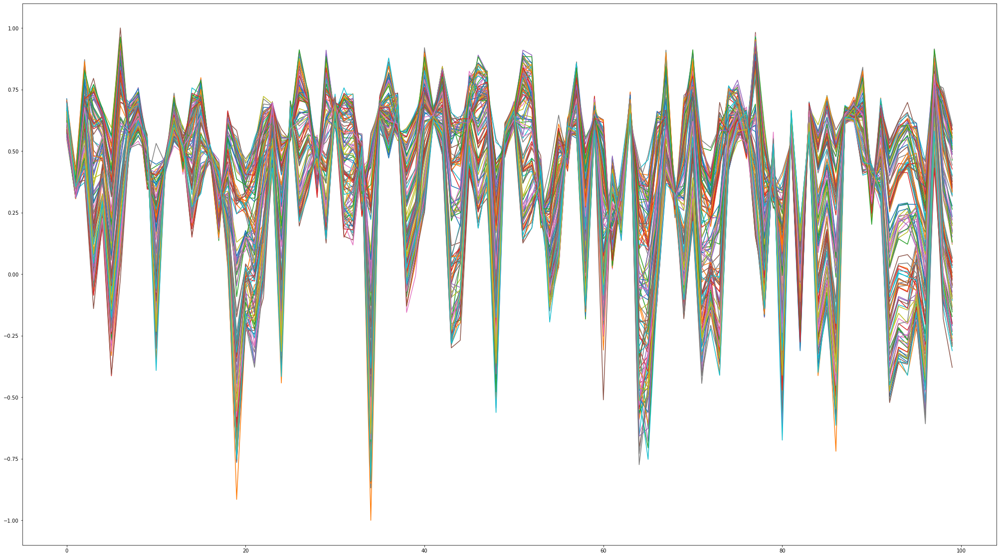

In [16]:
ts_array_scaled = np.array_split(ts_scaled_test, 100)
#convert list in numpy array
ts_nps = np.array(ts_array_scaled)
plt.figure(figsize=(35,20))
plt.plot(ts_array_scaled)
plt.show()

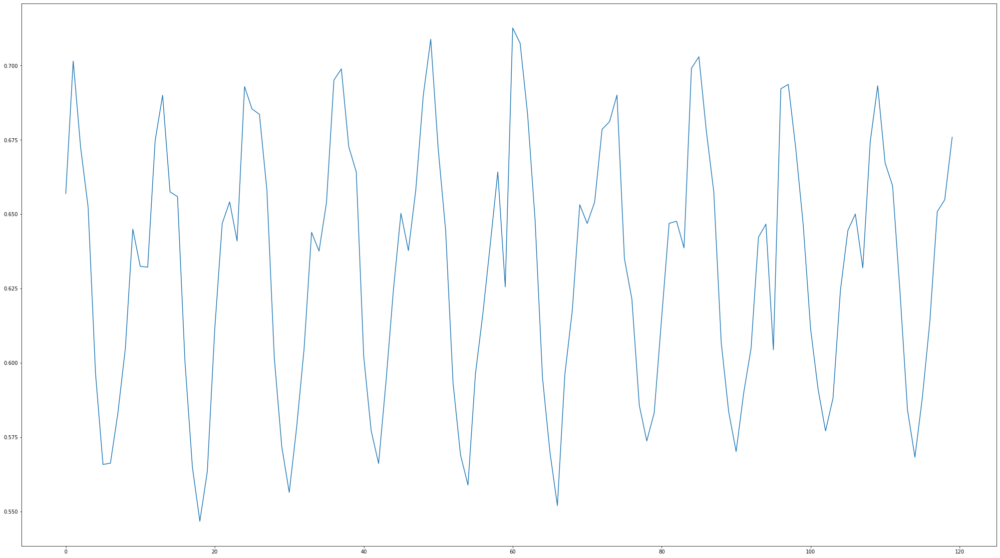

In [17]:
#example with one city (Abidjan)
plt.figure(figsize=(35,20))
plt.plot(ts_array_scaled[0])
plt.show()

## Computing distance between time series

In this part, we have computed the distance between some time series to examine the similarity of some temperature trends. In this case, we have used itakura global constraint. 

In [18]:
from pyts.metrics import dtw as dtw2
sim, path = dtw2(ts_array_scaled[18].ravel(), ts_array_scaled[42].ravel(), dist='square', method='itakura', return_path=True)

In [19]:
path[0]

array([  0,   1,   2,   3,   4,   5,   6,   6,   6,   6,   6,   6,   7,
         8,   9,  10,  11,  12,  13,  14,  15,  16,  17,  18,  18,  18,
        18,  18,  18,  18,  18,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  40,  41,  42,  42,  42,  42,  42,  42,  42,  42,  42,
        42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,  42,
        42,  42,  42,  42,  42,  42,  42,  42,  42,  43,  44,  45,  46,
        47,  48,  49,  50,  51,  52,  53,  54,  55,  56,  57,  58,  59,
        60,  61,  62,  63,  64,  65,  66,  67,  68,  69,  70,  71,  72,
        73,  74,  75,  76,  76,  77,  77,  77,  77,  77,  77,  77,  77,
        77,  77,  77,  77,  77,  77,  77,  77,  77,  77,  77,  78,  79,
        80,  81,  82,  83,  84,  85,  86,  87,  88,  88,  89,  89,  89,
        89,  89,  89,  89,  89,  90,  91,  92,  93,  94,  95,  96,  97,
        98,  99, 100, 101, 101, 101, 101, 101, 101, 101, 101, 10

In [20]:
#show the path
new_p = list()
for i in range(0, len(path[0])):
    new_p.append((path[0][i], path[1][i]))

In [21]:
new_p

[(0, 0),
 (1, 1),
 (2, 1),
 (3, 2),
 (4, 2),
 (5, 3),
 (6, 4),
 (6, 5),
 (6, 6),
 (6, 7),
 (6, 8),
 (6, 9),
 (7, 10),
 (8, 11),
 (9, 11),
 (10, 11),
 (11, 11),
 (12, 11),
 (13, 11),
 (14, 11),
 (15, 12),
 (16, 13),
 (17, 13),
 (18, 14),
 (18, 15),
 (18, 16),
 (18, 17),
 (18, 18),
 (18, 19),
 (18, 20),
 (18, 21),
 (18, 22),
 (19, 23),
 (20, 23),
 (21, 23),
 (22, 23),
 (23, 23),
 (24, 23),
 (25, 23),
 (26, 23),
 (27, 23),
 (28, 23),
 (29, 23),
 (30, 23),
 (31, 23),
 (32, 23),
 (33, 23),
 (34, 23),
 (35, 23),
 (36, 23),
 (37, 23),
 (38, 23),
 (39, 23),
 (40, 24),
 (40, 25),
 (41, 26),
 (42, 27),
 (42, 28),
 (42, 29),
 (42, 30),
 (42, 31),
 (42, 32),
 (42, 33),
 (42, 34),
 (42, 35),
 (42, 36),
 (42, 37),
 (42, 38),
 (42, 39),
 (42, 40),
 (42, 41),
 (42, 42),
 (42, 43),
 (42, 44),
 (42, 45),
 (42, 46),
 (42, 47),
 (42, 48),
 (42, 49),
 (42, 50),
 (42, 51),
 (42, 52),
 (42, 53),
 (42, 54),
 (42, 55),
 (42, 56),
 (42, 57),
 (43, 58),
 (44, 59),
 (45, 59),
 (46, 59),
 (47, 59),
 (48, 59),
 (49

We have computed the Euclidean distance matrix between Casablanca and Jiddah and we have applied on matrix the path that we have computed previously.

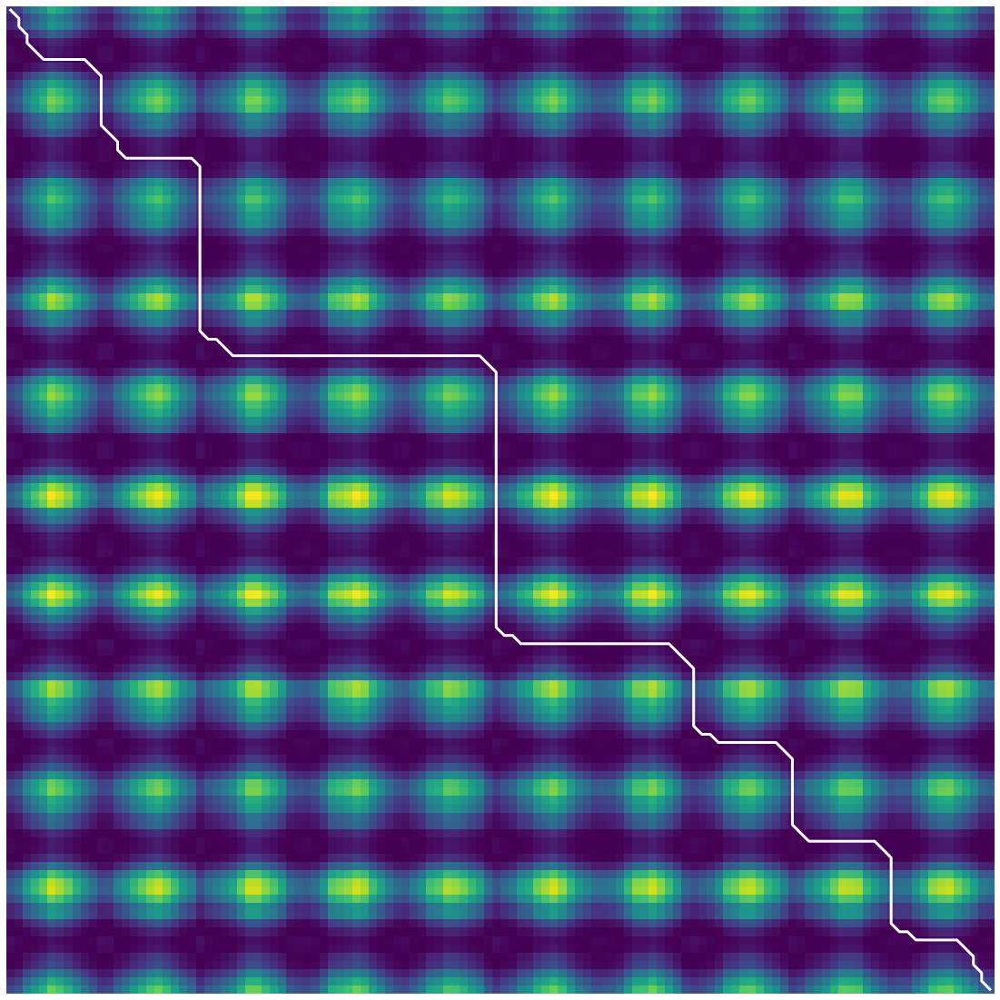

In [22]:
#we compute the euclidean distance
from scipy.spatial.distance import cdist
mat = cdist(ts_array_scaled[18].reshape(-1,1), ts_array_scaled[42].reshape(-1,1), 'sqeuclidean')
plt.figure(figsize=(35,20))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in new_p], [i for (i, j) in new_p], "w-", linewidth=3.)
plt.show()

After that, we have compared other cities, i.e. Ibadan with Nairobi and Baghdad with Wuhan using itakura costraint.

In [23]:
sim, path = dtw2(ts_array_scaled[37].ravel(), ts_array_scaled[68].ravel(), dist='square', method='itakura', return_path=True)
new_p = list()
for i in range(0, len(path[0])):
    new_p.append((path[0][i], path[1][i]))

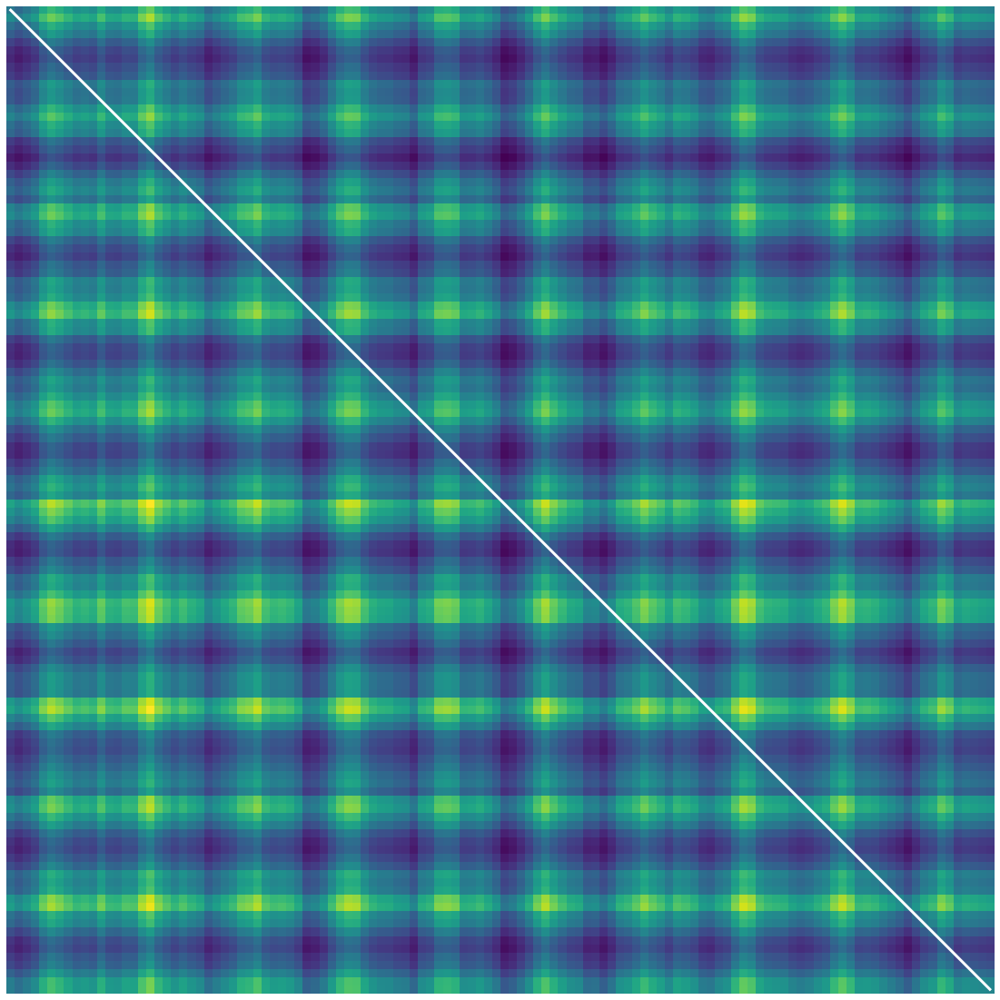

In [24]:
mat = cdist(ts_array_scaled[37].reshape(-1,1), ts_array_scaled[68].reshape(-1,1), 'sqeuclidean')
plt.figure(figsize=(35,20))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in new_p], [i for (i, j) in new_p], "w-", linewidth=3.)
plt.show()

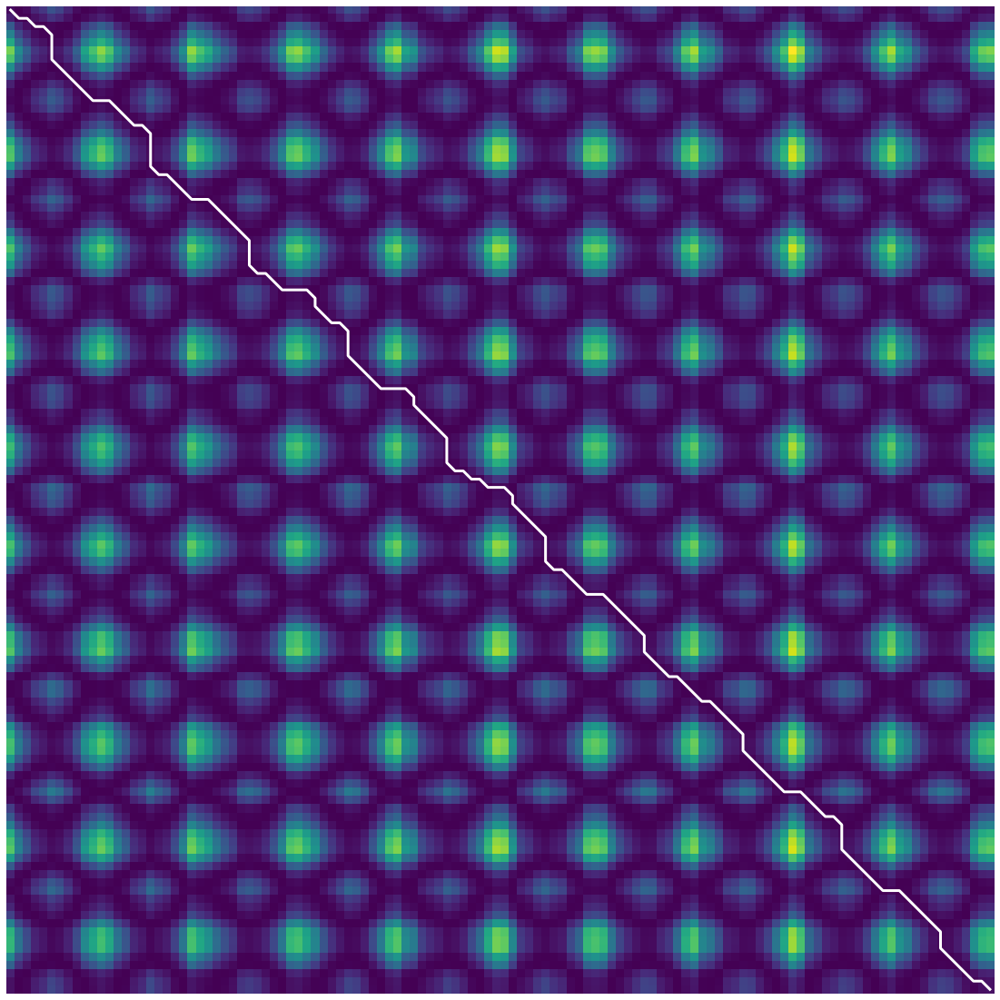

In [25]:
sim, path = dtw2(ts_array_scaled[6].ravel(), ts_array_scaled[98].ravel(), dist='square', method='itakura', return_path=True)
new_p = list()
for i in range(0, len(path[0])):
    new_p.append((path[0][i], path[1][i]))

mat = cdist(ts_array_scaled[6].reshape(-1,1), ts_array_scaled[98].reshape(-1,1), 'sqeuclidean')
plt.figure(figsize=(35,20))
plt.imshow(mat)
plt.axis("off")
plt.autoscale(False)
plt.plot([j for (i, j) in new_p], [i for (i, j) in new_p], "w-", linewidth=3.)
plt.show()

Finally, we have computed the distance of the path of all cities that we have compared previously.

In [26]:
from tslearn.metrics import dtw, dtw_path, cdist_dtw, subsequence_cost_matrix
path, dist = dtw_path(ts_array_scaled[18], ts_array_scaled[42], global_constraint="itakura", itakura_max_slope=None)
dist

2.9055009430522087

In [27]:
path, dist = dtw_path(ts_array_scaled[6], ts_array_scaled[98], global_constraint="itakura", itakura_max_slope=None)
dist

1.480626177198838

In [28]:
path, dist = dtw_path(ts_array_scaled[37], ts_array_scaled[68], global_constraint="itakura", itakura_max_slope=None)
dist

3.6697144086916498

## Structure-based similarity

In this section, we have measured similarities between time series using some statistical features. Indeed, first, we have created a function to extract these features such as mean, percentiles, median, and so on.
After that, we have computed the Euclidean distance with previous cities tested.

In [29]:
#define a function to extract statistical features
import scipy.stats as stats
def calculate_features(values):
    features = {
        'avg': np.mean(values),
        'std': np.std(values),
        'var': np.var(values),
        'med': np.median(values),
        '10p': np.percentile(values, 10),
        '25p': np.percentile(values, 25),
        '50p': np.percentile(values, 50),
        '75p': np.percentile(values, 75),
        '90p': np.percentile(values, 90),
        'iqr': np.percentile(values, 75) - np.percentile(values, 25),
        'cov': 1.0 * np.mean(values) / np.std(values),
        'skw': stats.skew(values),
        'kur': stats.kurtosis(values)
    }

    return features

In [30]:
#create list to store statistical features per time series
features_ts_array = []

for i in range(len(ts_array_scaled)):
    features_ts_array.append(calculate_features(ts_array_scaled[i]))

In [31]:
list(features_ts_array[0].values())

[0.6324702968694356,
 0.042960890495059564,
 0.0018456381121284991,
 0.6404869047233642,
 0.5700832011395641,
 0.5957460584674152,
 0.6404869047233642,
 0.6641603807180547,
 0.6902295315484477,
 0.06841432225063948,
 14.722001559585193,
 -0.10764408354041571,
 -1.0510272309120499]

We have computed the Euclidean distance with the previous cities.

In [32]:
from scipy.spatial.distance import euclidean
euclidean(list(features_ts_array[18].values()), list(features_ts_array[42].values()))

4.550000150111289

In [33]:
euclidean(list(features_ts_array[37].values()), list(features_ts_array[68].values()))

4.298582171497902

In [34]:
euclidean(list(features_ts_array[6].values()), list(features_ts_array[98].values()))

0.7856834145235625

## Approximation of time series

In this section, we have applied the approximation of time series for reducing dimensionality. The approximation is in a simpler space and always understandable.
So, we have applied __piece-wise aggregate__, __symbolic aggregate__, and __one-dimensional symbolic aggregate__ approximation.

### Piece-wise Aggregate Approximation

In [35]:
from tslearn.piecewise import PiecewiseAggregateApproximation
from tslearn.preprocessing import TimeSeriesScalerMeanVariance

Firstly, we have removed noise using the scaler min-max.

In [36]:
scaler = TimeSeriesScalerMinMax(value_range=(-1., 1.))  
ts1 = []
for i in range(len(ts_array)):    
    ts1.append(scaler.fit_transform(ts_array[i]["AverageTemperature"].values.reshape(1,-1)))

In [37]:
#select the number of segments to compute 
n_paa_segments = 20
paa = PiecewiseAggregateApproximation(n_segments=n_paa_segments)
ts_paa = []
paa_dataset_inv = []
for i in range(len(ts1)):    
    ts_paa.append(paa.fit_transform(ts1[i]))
    paa_dataset_inv.append(paa.inverse_transform(ts_paa[i]))

In [38]:
ts_paa

[array([[[ 0.13541463],
         [-0.22946341],
         [ 0.13144715],
         [-0.22998374],
         [ 0.23154472],
         [-0.20682927],
         [ 0.26543089],
         [-0.09398374],
         [ 0.19980488],
         [-0.15369106],
         [ 0.27895935],
         [-0.11700813],
         [ 0.22868293],
         [-0.14601626],
         [ 0.30074797],
         [-0.24136585],
         [ 0.25931707],
         [-0.12435772],
         [ 0.24930081],
         [-0.05209756]]]),
 array([[[ 0.22068546],
         [-0.76609255],
         [ 0.12378219],
         [-0.57820111],
         [ 0.25948156],
         [-0.54575505],
         [ 0.26243911],
         [-0.66214335],
         [ 0.09490257],
         [-0.68275922],
         [ 0.22616562],
         [-0.65135699],
         [ 0.24104036],
         [-0.60160056],
         [ 0.07080724],
         [-0.69954767],
         [ 0.04601601],
         [-0.74695546],
         [ 0.41083855],
         [-0.37752262]]]),
 array([[[ 0.31251486],
         [

In [39]:
paa_dataset_inv

[array([[[ 0.13541463],
         [ 0.13541463],
         [ 0.13541463],
         [ 0.13541463],
         [ 0.13541463],
         [ 0.13541463],
         [-0.22946341],
         [-0.22946341],
         [-0.22946341],
         [-0.22946341],
         [-0.22946341],
         [-0.22946341],
         [ 0.13144715],
         [ 0.13144715],
         [ 0.13144715],
         [ 0.13144715],
         [ 0.13144715],
         [ 0.13144715],
         [-0.22998374],
         [-0.22998374],
         [-0.22998374],
         [-0.22998374],
         [-0.22998374],
         [-0.22998374],
         [ 0.23154472],
         [ 0.23154472],
         [ 0.23154472],
         [ 0.23154472],
         [ 0.23154472],
         [ 0.23154472],
         [-0.20682927],
         [-0.20682927],
         [-0.20682927],
         [-0.20682927],
         [-0.20682927],
         [-0.20682927],
         [ 0.26543089],
         [ 0.26543089],
         [ 0.26543089],
         [ 0.26543089],
         [ 0.26543089],
         [ 0.265

### Symbolic Aggregate Approximation

In [40]:
from tslearn.piecewise import SymbolicAggregateApproximation
n_sax_symbols = 16
sax = SymbolicAggregateApproximation(n_segments=n_paa_segments, alphabet_size_avg=n_sax_symbols)

ts_sax = []
sax_dataset_inv = []
for i in range(len(ts1)):    
    ts_sax.append(sax.fit_transform(ts1[i]))
    sax_dataset_inv.append(sax.inverse_transform(ts_sax[i]))

### One Dimensional Symbolic Aggregate Approximation

In [41]:
from tslearn.piecewise import OneD_SymbolicAggregateApproximation
n_sax_symbols_avg = 16
n_sax_symbols_slope = 8
one_d_sax = OneD_SymbolicAggregateApproximation(
    n_segments=n_paa_segments,
    alphabet_size_avg=n_sax_symbols_avg,
    alphabet_size_slope=n_sax_symbols_slope)

ts_sax1d = []
one_d_sax_dataset_inv = []
for i in range(len(ts1)): 
    ts_sax1d.append(one_d_sax.fit_transform(ts1[i]))
    one_d_sax_dataset_inv.append(one_d_sax.inverse_transform(ts_sax1d[i]))


<Figure size 432x288 with 0 Axes>

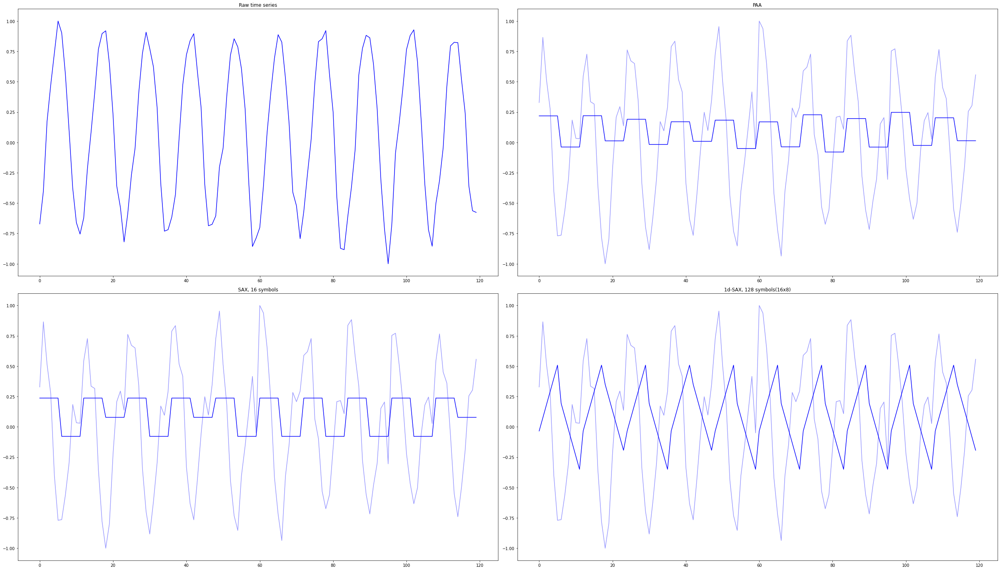

In [42]:
#visualization of just 1 time series
plt.figure()
plt.figure(figsize=(35,20))
plt.subplot(2, 2, 1)  # First, raw time series
plt.plot(ts1[6].ravel(), "b-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)  # Second, PAA
plt.plot(ts1[0].ravel(), "b-", alpha=0.4)
plt.plot(paa_dataset_inv[6].ravel(), "b-")
plt.title("PAA")

plt.subplot(2, 2, 3)  # Then SAX
plt.plot(ts1[0].ravel(), "b-", alpha=0.4)
plt.plot(sax_dataset_inv[6].ravel(), "b-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  # Finally, 1d-SAX
plt.plot(ts1[0].ravel(), "b-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[6].ravel(), "b-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

We have compared some time series using the same cities that we have analyzed previously.

<Figure size 432x288 with 0 Axes>

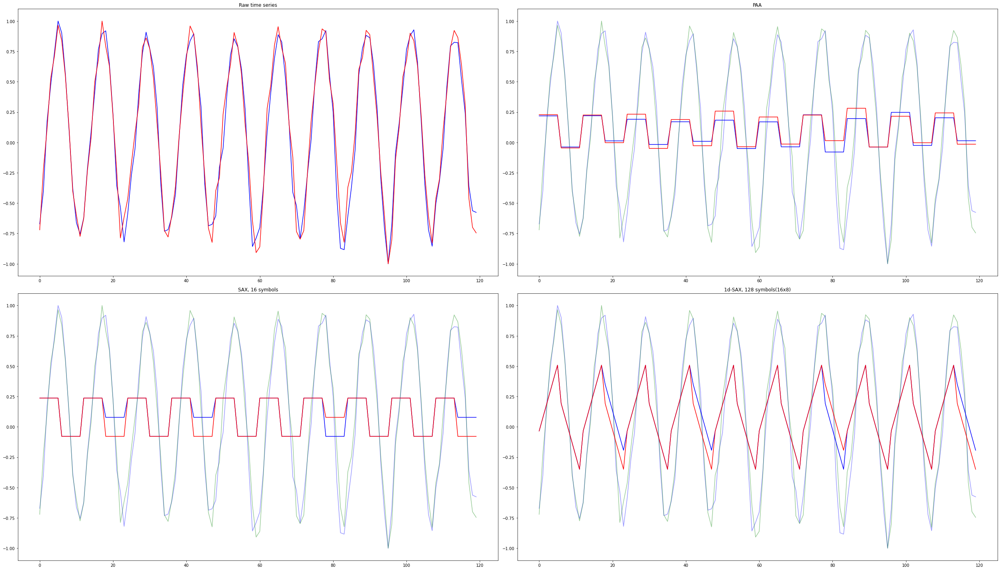

In [43]:
plt.figure()
plt.figure(figsize=(35,20))
plt.subplot(2, 2, 1)  
plt.plot(ts1[6].ravel(), "b-")
plt.plot(ts1[98].ravel(), "r-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)
plt.plot(ts1[6].ravel(), "b-", alpha=0.4)
plt.plot(ts1[98].ravel(), "g-", alpha=0.4)
plt.plot(paa_dataset_inv[6].ravel(), "b-")
plt.plot(paa_dataset_inv[98].ravel(), "r-")
plt.title("PAA")

plt.subplot(2, 2, 3) 
plt.plot(ts1[6].ravel(), "b-", alpha=0.4)
plt.plot(ts1[98].ravel(), "g-", alpha=0.4)
plt.plot(sax_dataset_inv[6].ravel(), "b-")
plt.plot(sax_dataset_inv[98].ravel(), "r-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  
plt.plot(ts1[6].ravel(), "b-", alpha=0.4)
plt.plot(ts1[98].ravel(), "g-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[6].ravel(), "b-")
plt.plot(one_d_sax_dataset_inv[98].ravel(), "r-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

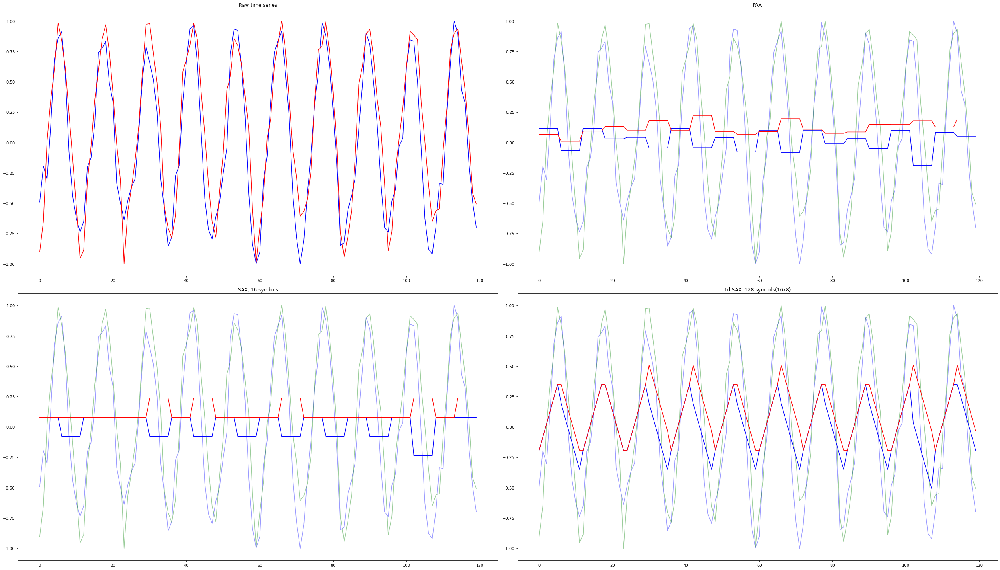

In [44]:
plt.figure()
plt.figure(figsize=(35,20))
plt.subplot(2, 2, 1)  
plt.plot(ts1[18].ravel(), "b-")
plt.plot(ts1[42].ravel(), "r-")
plt.title("Raw time series")

plt.subplot(2, 2, 2)
plt.plot(ts1[18].ravel(), "b-", alpha=0.4)
plt.plot(ts1[42].ravel(), "g-", alpha=0.4)
plt.plot(paa_dataset_inv[18].ravel(), "b-")
plt.plot(paa_dataset_inv[42].ravel(), "r-")
plt.title("PAA")

plt.subplot(2, 2, 3) 
plt.plot(ts1[18].ravel(), "b-", alpha=0.4)
plt.plot(ts1[42].ravel(), "g-", alpha=0.4)
plt.plot(sax_dataset_inv[18].ravel(), "b-")
plt.plot(sax_dataset_inv[42].ravel(), "r-")
plt.title("SAX, %d symbols" % n_sax_symbols)

plt.subplot(2, 2, 4)  
plt.plot(ts1[18].ravel(), "b-", alpha=0.4)
plt.plot(ts1[42].ravel(), "g-", alpha=0.4)
plt.plot(one_d_sax_dataset_inv[18].ravel(), "b-")
plt.plot(one_d_sax_dataset_inv[42].ravel(), "r-")
plt.title("1d-SAX, %d symbols"
          "(%dx%d)" % (n_sax_symbols_avg * n_sax_symbols_slope,
                       n_sax_symbols_avg,
                       n_sax_symbols_slope))

plt.tight_layout()
plt.show()

There we saw difference between the previous approximated time series by exploiting the compression function defined above.

In [45]:
import zlib
#definition of CDM
def CDM(x, y):
    return len(zlib.compress(x + y)) / (len(zlib.compress(x)) + len(zlib.compress(y)))

In [46]:
ts1_sax_enc = (' '.join([str(v) for v in ts_sax1d[6]])).encode('utf-8')
ts2_sax_enc = (' '.join([str(v) for v in ts_sax1d[98]])).encode('utf-8')

In [47]:
CDM(ts1_sax_enc, ts2_sax_enc)

0.6721311475409836

In [48]:
ts1_paa_enc = (' '.join([str(v) for v in ts_paa[6]])).encode('utf-8')
ts2_paa_enc = (' '.join([str(v) for v in ts_paa[98]])).encode('utf-8')

In [49]:
CDM(ts1_paa_enc, ts2_paa_enc)

0.8664259927797834

In [50]:
ts1_sax_enc = (' '.join([str(v) for v in ts_sax1d[18]])).encode('utf-8')
ts2_sax_enc = (' '.join([str(v) for v in ts_sax1d[42]])).encode('utf-8')
CDM(ts1_sax_enc, ts2_sax_enc)

0.734375

In [51]:
ts1_paa_enc = (' '.join([str(v) for v in ts_paa[18]])).encode('utf-8')
ts2_paa_enc = (' '.join([str(v) for v in ts_paa[42]])).encode('utf-8')
CDM(ts1_paa_enc, ts2_paa_enc)

0.8830188679245283

# Clustering

In this section, we have computed some clustering techniques for time series to find groups of similar cities with respect to the temperature trends.
First of all, we have found the best K for kmeans using the elbow method.

In [52]:
from tslearn.clustering import TimeSeriesKMeans
from sklearn.metrics import silhouette_samples, silhouette_score

In [53]:
kmeanselbow = list()  # the list where we'll save all the kmeans objects
silh_list   = list()  # the list where we'll save the silhouette score values for each k
sse_list    = list()  # the list where we'll save the sum of squared errors for each k
max_k       = 30      # the maximum number of k we'll test for

for k in range(2,max_k+1):
    kmeanselbow.append(TimeSeriesKMeans(n_clusters=k, metric="euclidean", max_iter=200, random_state=0))
    kmeanselbow[-1].fit(ts_nps)
    
    sse = kmeanselbow[-1].inertia_
    silh = silhouette_score(ts_nps, kmeanselbow[-1].labels_)
    
    sse_list.append(sse)
    silh_list.append(silh)

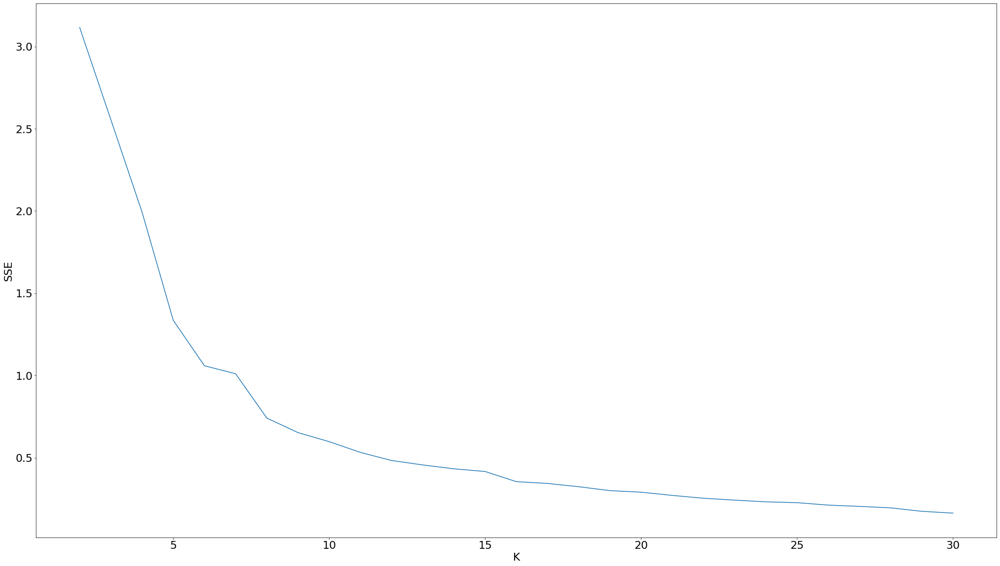

In [54]:
plt.figure(figsize=(35,20))
plt.plot(range(2, len(sse_list)+2), sse_list)
plt.ylabel('SSE', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.show()

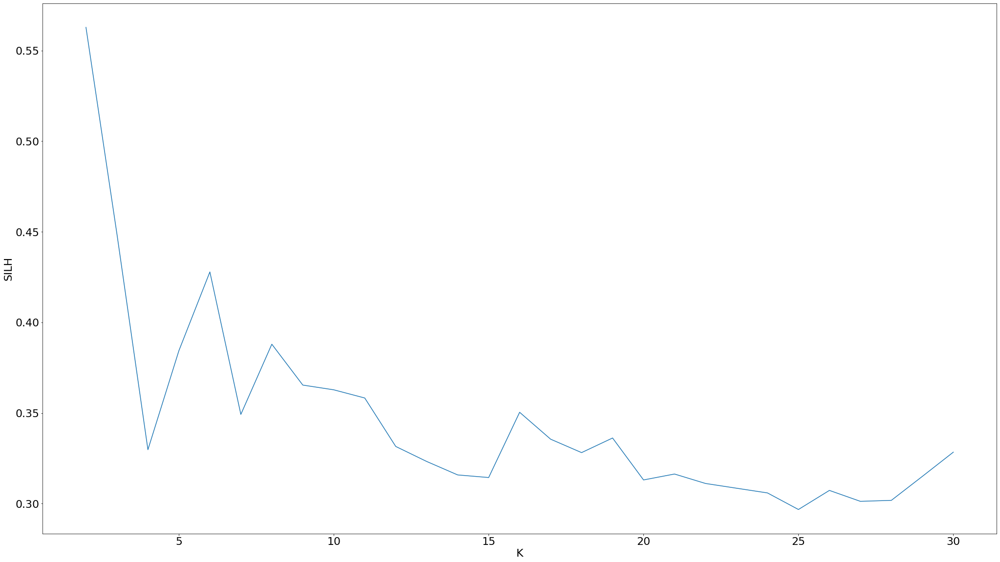

In [55]:
plt.figure(figsize=(35,20))
plt.plot(range(2, len(silh_list)+2), silh_list)
plt.ylabel('SILH', fontsize=22)
plt.xlabel('K', fontsize=22)
plt.tick_params(axis='both', which='major', labelsize=22)
plt.show()

## Shape-based clustering 

We have applied the k-means with the result achieved by the elbow method, i.e. 7 clusters.

In [56]:
km = TimeSeriesKMeans(n_clusters=7, metric="euclidean", max_iter=200, random_state=0)
km.fit(ts_nps)

TimeSeriesKMeans(max_iter=200, n_clusters=7, random_state=0)

And we plotted the cluster centers to see if there are differences among the different centroids.

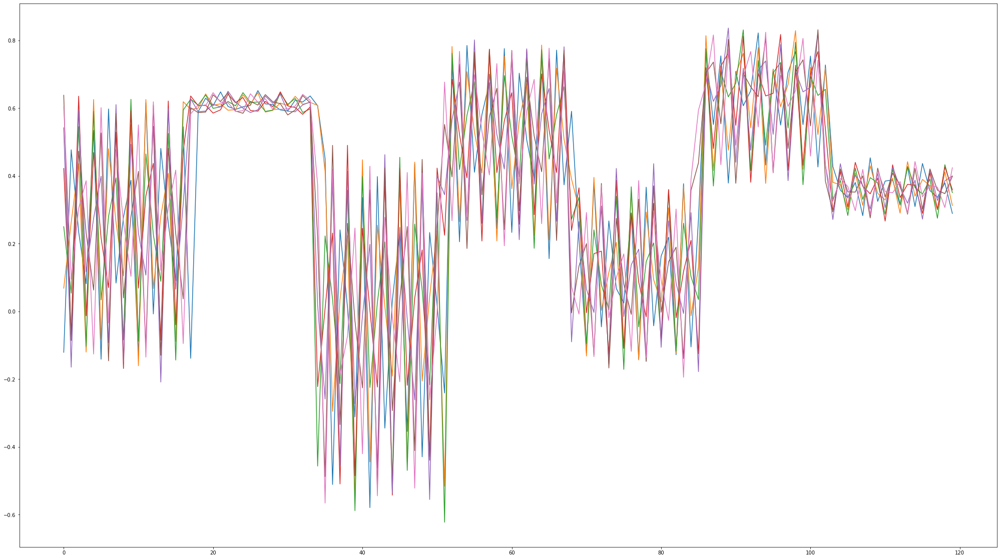

In [57]:
plt.figure(figsize=(35,20))
plt.plot(km.cluster_centers_.reshape(ts_nps.shape[1], 7))
plt.show()

In this part, we have used a different metric to separate better the clusters.

In [58]:
km_dtw = TimeSeriesKMeans(n_clusters=7, metric="dtw", max_iter=200, random_state=0)
km_dtw.fit(ts_nps)

TimeSeriesKMeans(max_iter=200, metric='dtw', n_clusters=7, random_state=0)

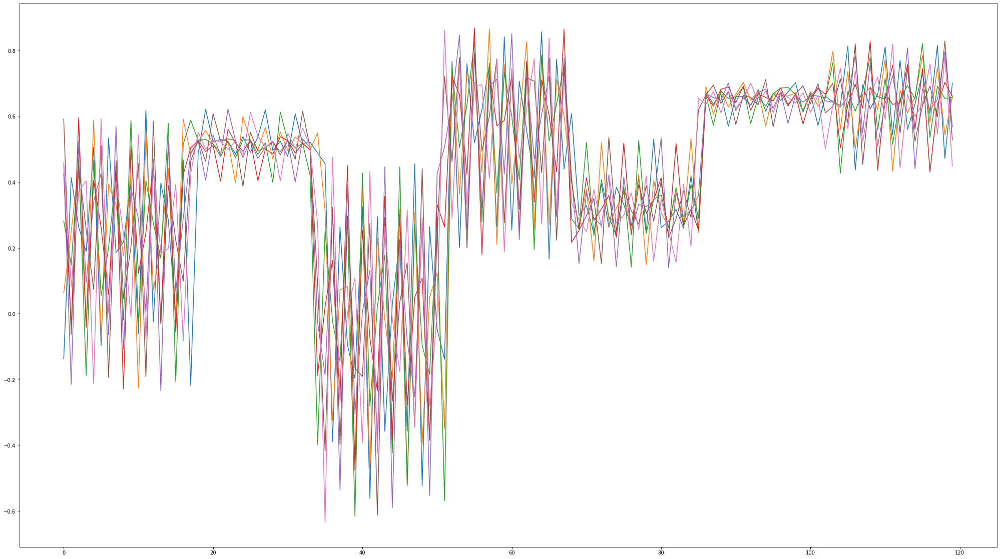

In [59]:
plt.figure(figsize=(35,20))
plt.plot(km_dtw.cluster_centers_.reshape(ts_nps.shape[1], 7))
plt.show()

In [60]:
#sum of distances of samples to their closest cluster center computed with euclidean distance
km.inertia_

1.010286547439324

In [61]:
#sum of distances of samples to their closest cluster center computed with dynamic time warping.
km_dtw.inertia_

0.42644574644111366

With shape-based clustering, we have noticed that some differences between the two metrics. In the __'euclidean'__ metric the second, fifth and seventh groupings provide a slightly higher overlapping with respect to __'dtw'__ version. But, in the sixth grouping the __'euclidean'__ metric has a well separated clustering than other one.
In general, the __'dtw'__ metric shows better results, indeed the dtw inertia measurement is less than euclidean's inertia.

## Features-based clustering

In this part we have evaluated the clustering using statistical features that we extracted above. Then, we used K-means to find the clusters. In this case, we have used the same number of clusters that we have found with the elbow method.

In [62]:
#put the statistical features in the list
F = [list(calculate_features(x).values())[:-2] for x in ts_nps]

In [63]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=7)
kmeans.fit(F)

KMeans(n_clusters=7)

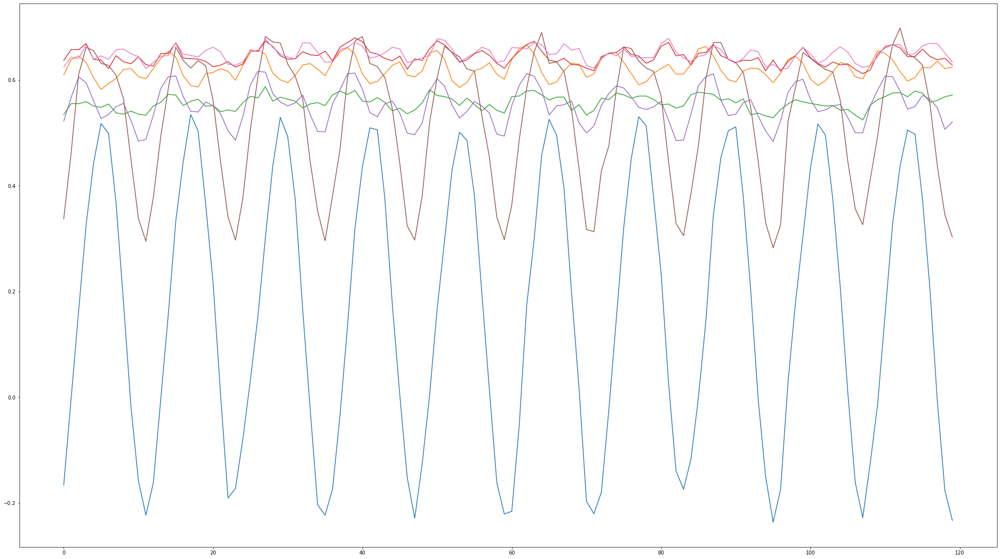

In [64]:
plt.figure(figsize=(35,20))
for i in range(7):
    plt.plot(np.mean(ts_nps[np.where(kmeans.labels_ == i)], axis=0))
plt.show()

In [65]:
kmeans.inertia_

183.67680436248213

The feature-based clustering shows well-separated clusters with respect to the previous technique, but we have not had a good inertia value.

## Compression-based clustering 

In the last method, we have used the compression-based dissimilarity to find similar cities. 
Then, we have used __piece wise aggregate__ approximation and K-means with 7 clusters.

In [66]:
X_paa = paa.fit_transform(ts_nps)

/home/feeded/anaconda3/lib/python3.8/site-packages/tslearn/utils/utils.py:88: UserWarning: 2-Dimensional data passed. Assuming these are 100 1-dimensional timeseries
  warnings.warn('2-Dimensional data passed. Assuming these are '


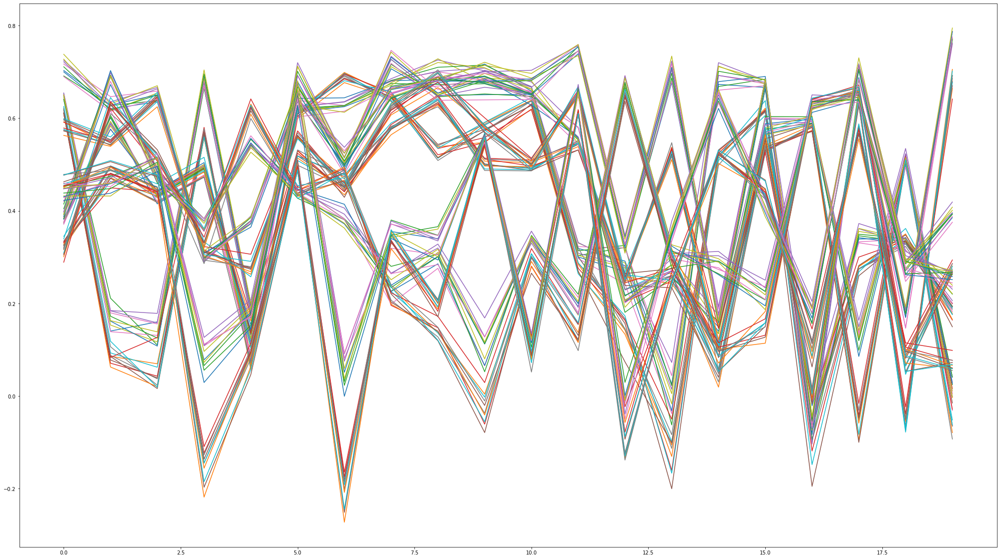

In [67]:
plt.figure(figsize=(35,20))
plt.plot(X_paa.reshape(X_paa.shape[1], X_paa.shape[0]))
plt.show()

In [68]:
km = TimeSeriesKMeans(n_clusters=7, metric="euclidean", max_iter=200, random_state=0)
km.fit(X_paa)

TimeSeriesKMeans(max_iter=200, n_clusters=7, random_state=0)

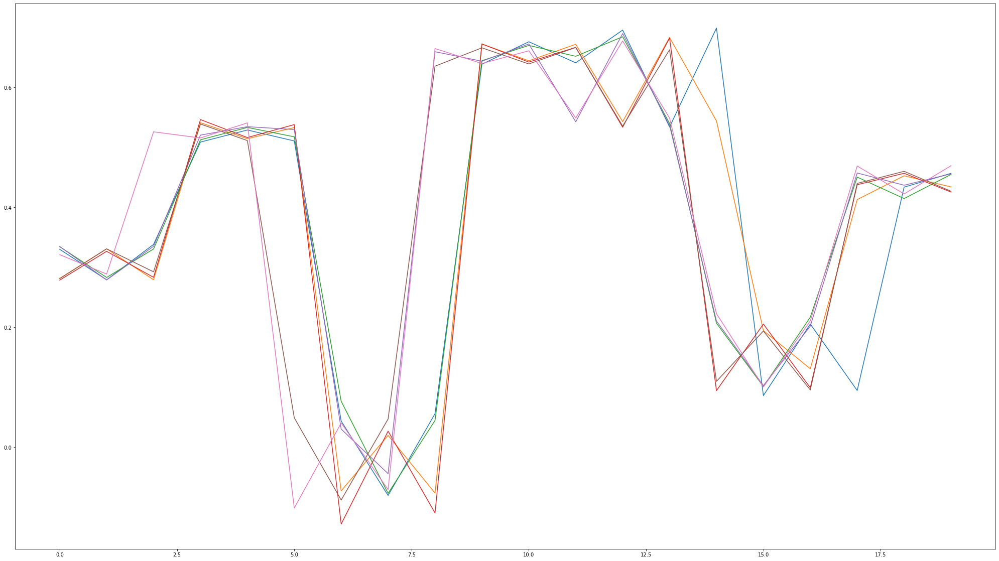

In [69]:
plt.figure(figsize=(35,20))
plt.plot(km.cluster_centers_.reshape(X_paa.shape[1], 7))
plt.show()

Compression-based clustering shows some clusters that overlap among them.

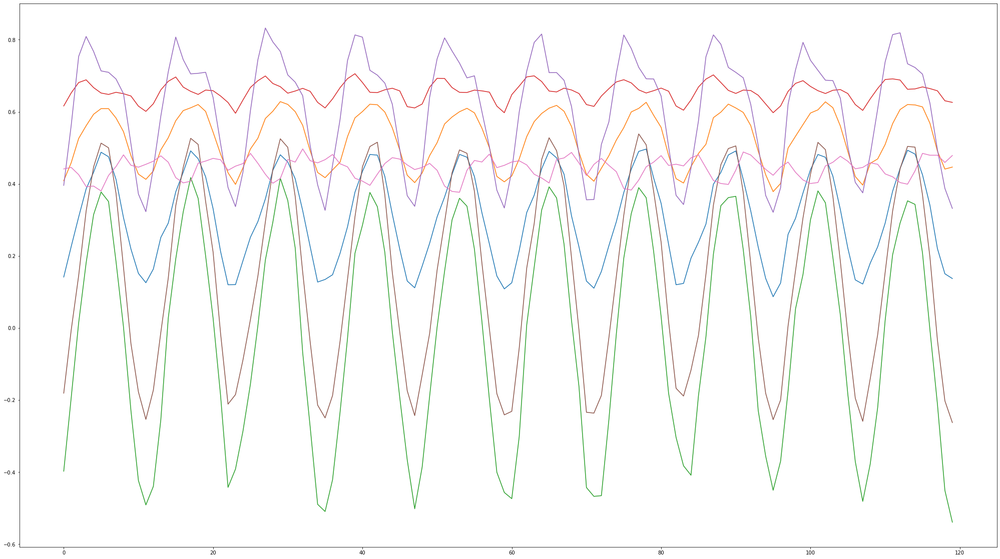

In [70]:
plt.figure(figsize=(35,20))
for i in range(7):
    plt.plot(np.mean(ts_nps[np.where(km.labels_ == i)[0]], axis=0))
plt.show()

In this section, we have compared the previous clustering techniques with __6__ clusters.

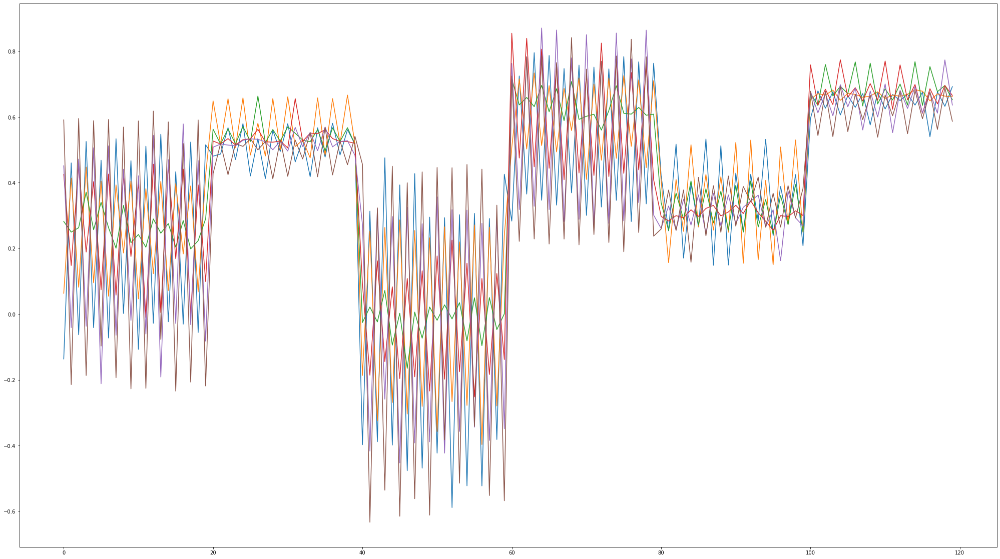

In [71]:
km_dtw1 = TimeSeriesKMeans(n_clusters=6, metric="dtw", max_iter=200, random_state=0)
km_dtw1.fit(ts_nps)

plt.figure(figsize=(35,20))
plt.plot(km_dtw1.cluster_centers_.reshape(ts_nps.shape[1], 6))
plt.show()

In [72]:
km_dtw1.inertia_

0.4680145153234865

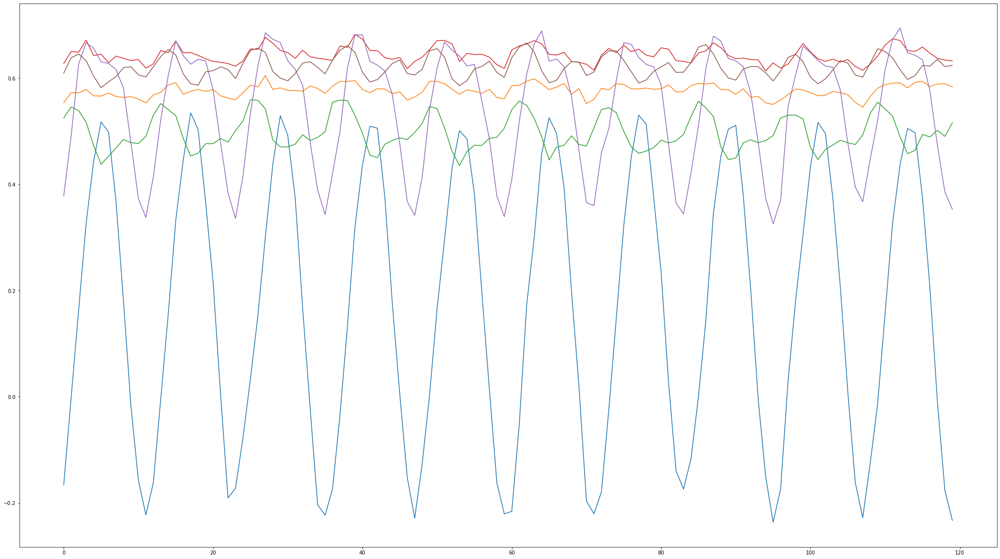

In [73]:
kmeans = KMeans(n_clusters=6)
kmeans.fit(F)

plt.figure(figsize=(35,20))
for i in range(6):
    plt.plot(np.mean(ts_nps[np.where(kmeans.labels_ == i)], axis=0))
plt.show()

In [74]:
kmeans.inertia_

245.16085559255276

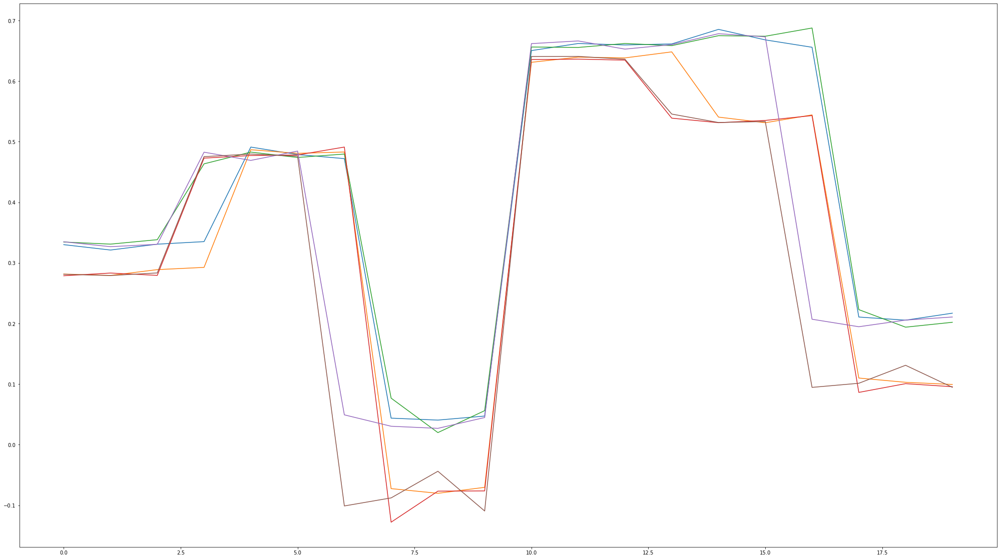

In [75]:
km = TimeSeriesKMeans(n_clusters=6, metric="euclidean", max_iter=200, random_state=0)
km.fit(X_paa)

plt.figure(figsize=(35,20))
plt.plot(km.cluster_centers_.reshape(X_paa.shape[1], 6))
plt.show()

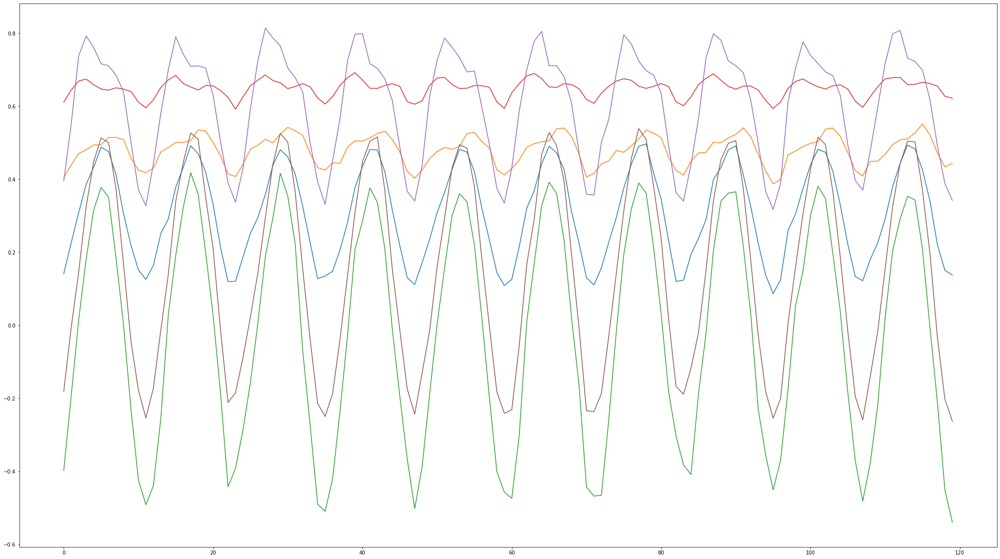

In [76]:
plt.figure(figsize=(35,20))
for i in range(6):
    plt.plot(np.mean(ts_nps[np.where(km.labels_ == i)[0]], axis=0))
plt.show()

We have noticed that the clustering with __6__ clusters is more or less similar to clustering with __7__ clusters, but it shows slightly worse results with respect to the other one. 

Indeed, the shape-based clustering with __6__ clusters shows a greater inertia measurement than __7__ clusters. Moreover, we have seen in compression-based clustering with __6__ clusters we have a more overlap with respect to the other one. 

Then, we can define __7__ groups of similar cities with respect to the temperature trends where we can achieve a good clustering.